In [4]:
import os
import subprocess
import sys
import shutil
from pathlib import Path
%load_ext autoreload
%autoreload 2

# install Stability SDK for Python
sdk_path = Path('./stability-sdk')
sdk_installed = os.path.exists(sdk_path)
package_installed = 'stability_sdk' in sys.modules
if sdk_path.exists() or package_installed:
    sys.path.append("./stability-sdk") # use local SDK src
else:
    %pip install ftfy grpcio grpcio-tools Pillow librosa pydub stability-sdk[anim_ui]
    if sdk_path.exists():
        shutil.rmtree(sdk_path)
        sub_p_res = subprocess.run(['pip', 'uninstall', '-y', 'stability-sdk'], stdout=subprocess.PIPE).stdout.decode('utf-8')
        print(sub_p_res)
    sub_p_res = subprocess.run(['git', 'clone', '-b', 'anima_stable', '--recurse-submodules', 'https://github.com/Stability-AI/stability-sdk'], stdout=subprocess.PIPE).stdout.decode('utf-8')
    print(sub_p_res)
    Path("./stability-sdk/src/stability_sdk/interfaces/__init__.py").touch()
    sub_p_res = subprocess.run(['pip', 'install', './stability-sdk[anim_ui]'], stdout=subprocess.PIPE).stdout.decode('utf-8')
    print(sub_p_res)


['Apricots.wav',
 'apricots_longer.wav',
 'follow_you.wav',
 'good_love.wav',
 'juju.wav',
 'juju_longer.wav',
 'juju_med.wav',
 'you_and_i.wav']

'saving to'

'.\\20230527145657'

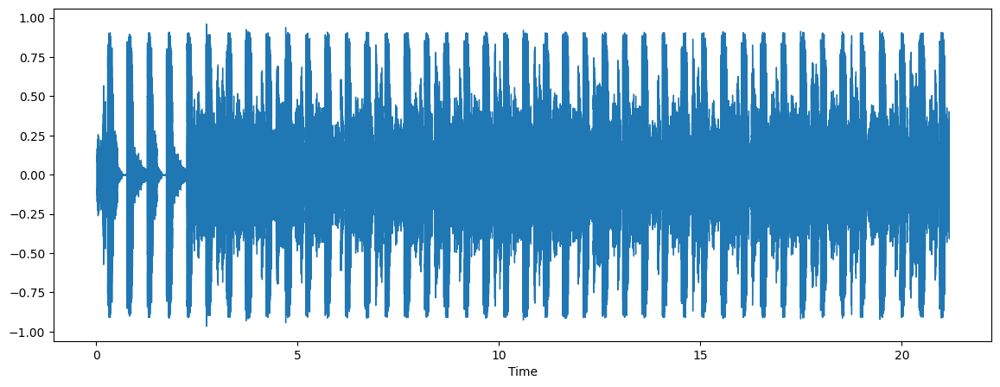

In [2]:
from tqdm.auto import tqdm
import os
from base64 import b64encode
from datetime import datetime

from stability_sdk.api import Context
from IPython.display import display, clear_output, Audio
from pydub import AudioSegment
from pydub.playback import play
import librosa
import matplotlib.pyplot as plt
import librosa.display
import librosa.display

# audio_dir = 'F:\Google Drive\My Drive\AudioVisSnippets'
audio_dir = './AudioVisSnippets/'
os.makedirs(audio_dir, exist_ok=True)

display(os.listdir(audio_dir))

audio_file_path = f"{audio_dir}/good_love.wav"

y, sr = librosa.load(audio_file_path)

plt.figure(figsize=(14, 5))
librosa.display.waveshow(y, sr=sr)


outputs_path = "."
timestring = datetime.now().strftime('%Y%m%d%H%M%S')
out_dir = os.path.join(outputs_path, timestring)
os.makedirs(out_dir, exist_ok=True)
display('saving to', out_dir)

tempo 61.5234375 beats [ 33  76 118 161 203 245 288 330 373 415 457 500 542 584 627 669 711 754
 796 838]


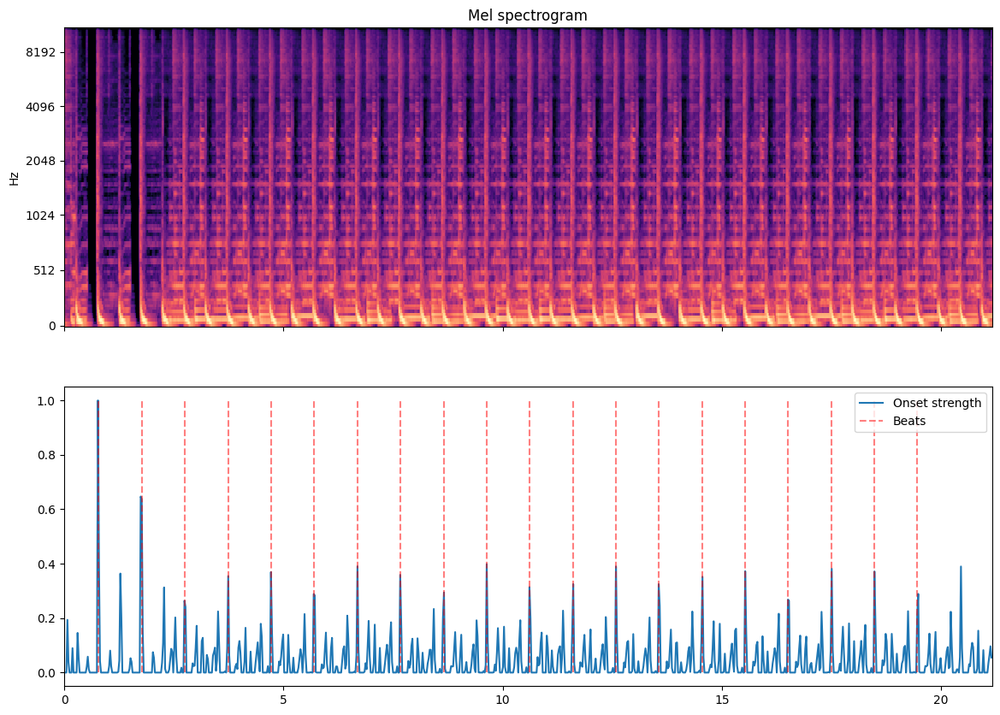

In [3]:
import matplotlib.pyplot as plt
import numpy as np
tempo, beats = librosa.beat.beat_track(y=y, sr=sr)
print("tempo", tempo, "beats", beats)
hop_length = 512
fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(14, 10))
onset_env = librosa.onset.onset_strength(y=y, sr=sr,
                                         aggregate=np.median)
times = librosa.times_like(onset_env, sr=sr, hop_length=hop_length)
M = librosa.feature.melspectrogram(y=y, sr=sr, hop_length=hop_length)
librosa.display.specshow(librosa.power_to_db(M, ref=np.max),
                         y_axis='mel', x_axis='time', hop_length=hop_length,
                         ax=ax[0])
ax[0].label_outer()
ax[0].set(title='Mel spectrogram')
ax[1].plot(times, librosa.util.normalize(onset_env),
         label='Onset strength')
ax[1].vlines(times[beats], 0, 1, alpha=0.5, color='r',
           linestyle='--', label='Beats')
ax[1].legend()



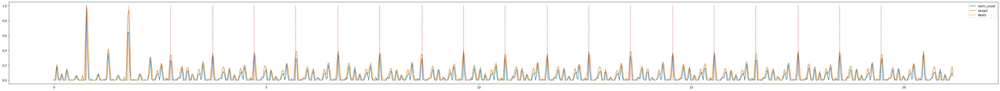

In [4]:
norm_onset = librosa.util.normalize(onset_env)
# times is times in seconds for each frame
from scipy.signal import savgol_filter    

sav_filtered = librosa.util.normalize(np.clip(savgol_filter(norm_onset, 9, 5), 0, 1))

fig, ax = plt.subplots()
fig.set_size_inches(60, 5)
ax.plot(times, norm_onset, label='norm_onset')
ax.plot(times, sav_filtered, label='savgol')
ax.vlines(times[beats], 0, 1, alpha=0.5, color='r',
           linestyle='--', label='Beats')
ax.legend()


In [12]:
from typing import List
from tqdm.auto import tqdm
import os
from stability_sdk import client
from datetime import datetime
import numpy as np

from stability_sdk.api import Context
from IPython.display import display, clear_output

# print(deforum_keyframes)
# convert 2d np array of (ts, mag) to deforum frames

def sample_array(arr, rate):
  arr = np.array(arr)
  if rate < 1:
    rate = int(1 / rate)
    num_samples = rate - 1
    print(num_samples)
    sampled = np.hstack([np.linspace(arr[i], arr[i+1], num_samples+2, endpoint=False)[1:] for i in range(len(arr)-1)])
    sampled = np.hstack([arr, sampled])
    sampled.sort()
  else:
    sampled = arr[::rate]
  return sampled

fps = 24

# times are in sec
# adsr_times = decay, release
# adsr_mags = on_value, decay_value, off_value
def beats_deforum(beats, adsr_times: List[float], adsr_mags: List[float], every_n: int = 1):
  decay, release = adsr_times
  on_value, decay_value, off_value = adsr_mags
  frames = [(0, off_value)]
  beats = sample_array(beats, every_n)
  for i in range(0, len(beats)):
    time = round(beats[i], 3)
    keyframes = np.transpose((np.round([time, time + decay, time + decay + release], 3), [on_value, decay_value, off_value]))
    frames.extend([(int(k[0] * fps), k[1]) for k in keyframes])
  
  frames = sorted(frames, key=lambda x: x[0])

  # remove duplicate time entries
  found_keyframes = set()
  for kf, val in frames:
    if kf in found_keyframes:
      frames.remove((kf, val))
    else:
      found_keyframes.add(kf)
  frames = [f"{frame}:({mag})" for frame, mag in frames]
  return ",".join(frames)

def beats_prompts(beat_times, prompts):
  prompt_idx = 0
  res = {
      0: prompts[0]
  }
  for i in range(len(beat_times)):
    time = round(beat_times[i], 3)
    frame = int(time * fps)
    prompt_idx = 0 if prompt_idx == len(prompts) - 1 else prompt_idx + 1
    res[frame] = prompts[prompt_idx]
  return res


first = "an iridescent hibiscus by beeple and yusuke murata and makoto shinkai, 8 k, 3 d high resolution render, cinematic, unreal engine, featured on artstation, epic scale, volumetric lighting, ultra wide angle, intricate details, crystal, rainbow colors"
second = "Fractal landscape of geometric shapes and patterns, complex, intricate, abstract, digital art"
bt = times[beats]
# print(bt)
# print(sample_array(bt, 0.1))
z_curve = beats_deforum(bt, [0.2, 0.2], [2, 0.5, 0.2], every_n=0.5)
cadence_curve = beats_deforum(bt, [0.2, 0.2], [2, 0.5, 0.2], every_n=2)
strength_curve = beats_deforum(bt, [0.2, 0], [0.65, 0.2, 0.1], every_n=0.5)
noise_scale_curve = beats_deforum(bt, [0.2, 0], [0.99, 0.9, 0.8], every_n=2)
display('z', z_curve)
display('cadence', cadence_curve)
display('strength', strength_curve)
display('noise_scale', noise_scale_curve)

1
1


'z'

'0:(0.2),18:(2.0),23:(0.5),26:(2.0),27:(0.2),31:(0.5),34:(2.0),35:(0.2),39:(0.5),42:(2.0),43:(0.2),47:(0.5),50:(2.0),51:(0.2),54:(0.5),57:(2.0),59:(0.2),62:(0.5),65:(2.0),67:(0.2),70:(0.5),73:(2.0),75:(0.2),78:(0.5),81:(2.0),83:(0.2),86:(0.5),89:(2.0),91:(0.2),94:(0.5),97:(2.0),99:(0.2),102:(0.5),105:(2.0),107:(0.2),110:(0.5),113:(2.0),114:(0.2),117:(0.5),120:(2.0),122:(0.2),125:(0.5),128:(2.0),130:(0.2),133:(0.5),136:(2.0),138:(0.2),141:(0.5),144:(2.0),146:(0.2),149:(0.5),152:(2.0),154:(0.2),157:(0.5),160:(2.0),162:(0.2),165:(0.5),168:(2.0),170:(0.2),173:(0.5),176:(2.0),177:(0.2),180:(0.5),183:(2.0),185:(0.2),188:(0.5),191:(2.0),193:(0.2),196:(0.5),199:(2.0),201:(0.2),204:(0.5),207:(2.0),209:(0.2),212:(0.5),215:(2.0),217:(0.2),220:(0.5),223:(2.0),225:(0.2),228:(0.5),231:(2.0),233:(0.2),236:(0.5),239:(2.0),240:(0.2),243:(0.5),246:(2.0),248:(0.2),251:(0.5),254:(2.0),256:(0.2),259:(0.5),262:(2.0),264:(0.2),267:(0.5),270:(2.0),272:(0.2),275:(0.5),278:(2.0),280:(0.2),283:(0.5),286:(2.0),28

'cadence'

'0:(0.2),18:(2.0),23:(0.5),27:(0.2),65:(2.0),70:(0.5),75:(0.2),113:(2.0),117:(0.5),122:(0.2),160:(2.0),165:(0.5),170:(0.2),207:(2.0),212:(0.5),217:(0.2),254:(2.0),259:(0.5),264:(0.2),302:(2.0),306:(0.5),311:(0.2),349:(2.0),354:(0.5),359:(0.2),396:(2.0),401:(0.5),405:(0.2),443:(2.0),448:(0.5),453:(0.2)'

'strength'

'0:(0.1),18:(0.65),23:(0.2),26:(0.65),31:(0.2),34:(0.65),39:(0.2),42:(0.65),47:(0.2),50:(0.65),54:(0.2),57:(0.65),62:(0.2),65:(0.65),70:(0.2),73:(0.65),78:(0.2),81:(0.65),86:(0.2),89:(0.65),94:(0.2),97:(0.65),102:(0.2),105:(0.65),110:(0.2),113:(0.65),117:(0.2),120:(0.65),125:(0.2),128:(0.65),133:(0.2),136:(0.65),141:(0.2),144:(0.65),149:(0.2),152:(0.65),157:(0.2),160:(0.65),165:(0.2),168:(0.65),173:(0.2),176:(0.65),180:(0.2),183:(0.65),188:(0.2),191:(0.65),196:(0.2),199:(0.65),204:(0.2),207:(0.65),212:(0.2),215:(0.65),220:(0.2),223:(0.65),228:(0.2),231:(0.65),236:(0.2),239:(0.65),243:(0.2),246:(0.65),251:(0.2),254:(0.65),259:(0.2),262:(0.65),267:(0.2),270:(0.65),275:(0.2),278:(0.65),283:(0.2),286:(0.65),291:(0.2),294:(0.65),299:(0.2),302:(0.65),306:(0.2),309:(0.65),314:(0.2),317:(0.65),322:(0.2),325:(0.65),330:(0.2),333:(0.65),338:(0.2),341:(0.65),346:(0.2),349:(0.65),354:(0.2),357:(0.65),362:(0.2),365:(0.65),369:(0.2),372:(0.65),377:(0.2),380:(0.65),385:(0.2),388:(0.65),393:(0.2),396:

'noise_scale'

'0:(0.8),18:(0.99),23:(0.9),65:(0.99),70:(0.9),113:(0.99),117:(0.9),160:(0.99),165:(0.9),207:(0.99),212:(0.9),254:(0.99),259:(0.9),302:(0.99),306:(0.9),349:(0.99),354:(0.9),396:(0.99),401:(0.9),443:(0.99),448:(0.9)'

# Run inference

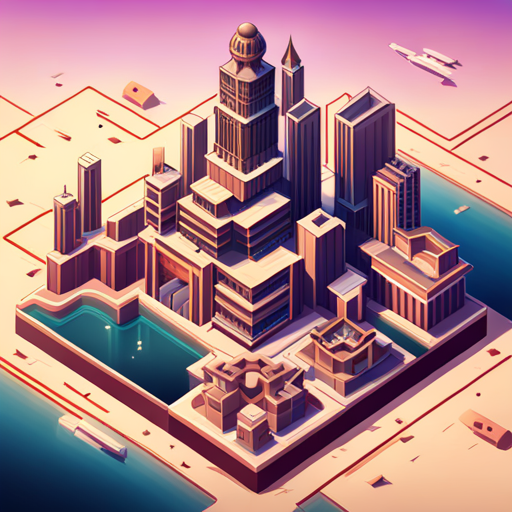

frame 1/507, took 3.82284 sec


KeyboardInterrupt: 

In [16]:
from stability_sdk.animation import AnimationArgs, Animator
from dotenv import load_dotenv, dotenv_values

config = dotenv_values(".env")

args = AnimationArgs()

max_frames = max(times) * fps
print(f"max frames: {max_frames}")

first = "an iridescent hibiscus by beeple and yusuke murata and makoto shinkai, intricate details, crystal, rainbow colors"
# second = "Upscaled Hyperdetailed portrait of an epic and dramatic stunning hillside Color-ritual scene, Intricate line art, finely detailed art station winner by Kilian Eng and by Jake Parker, vibrant colors, winning-award masterpiece, fantastically gaudy, aesthetic octane render, 8K HD Resolution"

# first = "isometric view illustration of a Cyberpunk apartment, highly detailed,  by James Gilleard and Bruce Pennington"
# second = "a psychedelic hallucination of a brutalist hotel in the high plains desert, by kawase hasui, moebius, edward hopper, colorful flat surreal design, dramatic lighting, hd, 8 k, artstation "

second = "A highly detailed digital art painting of a volcanic crystalline chasm at night, filled with glowing lava, shimmering starry nebula sky by Studio Ghibli, Makoto Shinkai, by Artgerm, by beeple, volumetric lighting, octane render, 4K resolution, trending on artstation, masterpiece, vivid colours"

# first = "Acrylic painting of a futuristic city, with neon lights, advanced technology, and flying cars, bold brushstrokes, high-contrast, highly stylized"
# second = "isometric webdesign icon for daytime city for toledo ohio, 3d render, high details, cinematic, by artgerm, tooth wu, dan mumford, beeple, wlop, rossdraws, james jean, andrei riabovitchev, marc simonetti, yoshitaka amano, artstation"


args.preset = "digital-art"
# args.clip_guidance = False # not supported with XL
args.animation_mode = '3D render'
args.seed = 63463
args.model = "stable-diffusion-xl-beta-v2-2-2"
args.locked_seed = False
args.interpolate_prompts = True
# args.noise_scale_curve = noise_scale_curve
args.strength_curve = strength_curve
args.translation_z = z_curve
args.diffusion_cadence_curve = cadence_curve
args.cadence_interp = 'film'
args.max_frames = int(max_frames)
args.fps = fps

print(args.translation_z)
print(args.diffusion_cadence_curve)
# args_vid_in.video_init_path = "/content/ocean.mp4"
# args_animation.animation_mode= 'Video Input'


# display.display(args)

# uploaded = files.upload()
def to_camelcase(s):
  return '_'.join(s.split(" "))

outputs_path = "."
timestring = datetime.now().strftime('%Y%m%d%H%M%S')
out_dir = os.path.join(outputs_path, timestring)
os.makedirs(out_dir, exist_ok=True)

height = 512
width = 512

GRPC_HOST = 'grpc.stability.ai:443'
API_KEY = config["API_KEY"]

api_context = Context(GRPC_HOST, API_KEY)

os.environ['STABILITY_HOST'] = GRPC_HOST
os.environ['STABILITY_KEY'] = API_KEY
channel = client.open_channel(GRPC_HOST, api_key=API_KEY)

beat_prompts = beats_prompts(np.arange(0, max_frames, 15), [first, second])
display(beat_prompts)
animator = Animator(
    api_context=api_context,
    animation_prompts=beat_prompts,
    args=args,
    out_dir=out_dir,    
)

last_frame_time = datetime.now()
i = 1
for frame in tqdm(animator.render(), initial=animator.start_frame_idx, total=args.max_frames):
    frame_time = datetime.now()
    clear_output(wait=True)
    display(frame) 
    duration_sec = (frame_time-last_frame_time).total_seconds()
    print(f"frame {i}/{args.max_frames}, took {duration_sec} sec")
    i += 1
    last_frame_time = frame_time

In [12]:
from datetime import datetime
import os
import subprocess
import shutil
from IPython.display import display, HTML

out_dir = "./20230524204717"

timestring = datetime.now().strftime('%Y%m%d%H%M%S')

video_name =  f"{timestring}.mp4"
image_path = os.path.join(out_dir, "frame_%05d.png")
mp4_path = os.path.join(out_dir, video_name)

print(f"Compiling animation frames to {mp4_path}...")


cmd = [
    'ffmpeg',
    '-y',
    '-vcodec', 'png',
    '-r', str(fps),
    '-start_number', str(0),
    '-i', image_path,
    '-i', audio_file_path,
    '-map', '0:v:0', '-map', '1:a:0',
    '-c:v', 'libx264',
    '-vf',
    f'fps={fps}',
    '-pix_fmt', 'yuv420p',
    '-crf', '17',
    '-preset', 'faster',
    mp4_path
]
print(cmd)
process = subprocess.Popen(cmd, stdout=subprocess.PIPE, stderr=subprocess.PIPE)
stdout, stderr = process.communicate()
if process.returncode != 0:
    print(stderr)
    raise RuntimeError(stderr)

mp4 = open(mp4_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
display(HTML(f'<video controls loop><source src="{data_url}" type="video/mp4"></video>') )

Compiling animation frames to ./20230524204717\20230525201607.mp4...
['ffmpeg', '-y', '-vcodec', 'png', '-r', '24', '-start_number', '0', '-i', './20230524204717\\frame_%05d.png', '-i', 'F:\\Google Drive\\My Drive\\AudioVisSnippets/good_love.wav', '-map', '0:v:0', '-map', '1:a:0', '-c:v', 'libx264', '-vf', 'fps=24', '-pix_fmt', 'yuv420p', '-crf', '17', '-preset', 'faster', './20230524204717\\20230525201607.mp4']
